Идеи:<br>
1) Предсказывать четыре resp, а не один и как-то использовать корреляцию<br>
2) Стоит ли брать в обучение weight == 0? <br>
3) Использовать time series (LSTM?) <br>
4) Feature Engineering в зависимости от тегов <br>
5) Поработать с пропусками <br>
6) Посмотреть на снижение размерности <br>
7) Решать как задачу регрессии <br>

In [1]:
# !pip install dabl
# !pip install datatable
# !pip install missingno
# !pip install gc
# !pip install plotly
# !pip install trimap

In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import trimap
colorMap = sns.light_palette("blue", as_cmap=True)

import dabl
import datatable as dt

import missingno as msno

import warnings
warnings.filterwarnings('ignore')
import os
from IPython.display import Image
import gc

## Load Data

In [4]:
%%time
train_data_datatable = dt.fread('train.csv')
train_data = train_data_datatable.to_pandas()
train_data.shape

Wall time: 20.3 s


(2390491, 138)

In [5]:
train_data.head()

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
0,0,0.000000,0.009916,0.014079,0.008773,0.001390,0.006270,1,-1.872746,-2.191242,...,NaN,1.168391,8.313583,1.782433,14.018213,2.653056,12.600292,2.301488,11.445807,0
1,0,16.673515,-0.002828,-0.003226,-0.007319,-0.011114,-0.009792,-1,-1.349537,-1.704709,...,NaN,-1.178850,1.777472,-0.915458,2.831612,-1.417010,2.297459,-1.304614,1.898684,1
2,0,0.000000,0.025134,0.027607,0.033406,0.034380,0.023970,-1,0.812780,-0.256156,...,NaN,6.115747,9.667908,5.542871,11.671595,7.281757,10.060014,6.638248,9.427299,2
3,0,0.000000,-0.004730,-0.003273,-0.000461,-0.000476,-0.003200,-1,1.174378,0.344640,...,NaN,2.838853,0.499251,3.033732,1.513488,4.397532,1.266037,3.856384,1.013469,3
4,0,0.138531,0.001252,0.002165,-0.001215,-0.006219,-0.002604,1,-3.172026,-3.093182,...,NaN,0.344850,4.101145,0.614252,6.623456,0.800129,5.233243,0.362636,3.926633,4


## Metrics

<b> Used Notebooks: </b><br>
    1) Score Function - https://www.kaggle.com/renataghisloti/understanding-the-utility-score-function

In [6]:
cols = ['weight'] + [col for col in train_data.columns if 'resp' in col]
train_data[cols].head()

,weight,resp_1,resp_2,resp_3,resp_4,resp
0,0.000000,0.009916,0.014079,0.008773,0.001390,0.006270
1,16.673515,-0.002828,-0.003226,-0.007319,-0.011114,-0.009792
2,0.000000,0.025134,0.027607,0.033406,0.034380,0.023970
3,0.000000,-0.004730,-0.003273,-0.000461,-0.000476,-0.003200
4,0.138531,0.001252,0.002165,-0.001215,-0.006219,-0.002604


<b> What our objective function? </b><br>
$p_i=\sum \limits_j(weight_{ij}∗resp_{ij}∗action_{ij})$ <br>
$ t = \frac{\sum p_i} {\sqrt {\sum p_i^2}} * \sqrt {\frac {250} {|i|}}$, where |i| - number of unique dates<br>
$ u = min(max(t, 0), 6) \sum p_i)$, where u - objective, which we want maximize

Из формул выше видно, что мы бы хотели максимизировать u, а для этого надо максимизировать $ \sum p_i $. Так как признака action у нас нет, нам необходимо определить его таким образом, чтобы это максимизировало $ \sum p_i $. Можем это сделать задав его бинарной переменной в зависимости от того положительный ли resp.

Если смотреть на t, то нам нужно стремиться к как можно меньшей вариации по дням, не очень понятно как этого достичь. Кроме того исходя из формулы для u нам нет смысла брать t > 6. Фактически мы ищем что-то вроде коэффициента Шарпа, который очень маловероятно будет выше 6, поэтому и такое ограничение (скорее всего). В целом наша метрика это просто попытка максимизировать произведение коэффициента Шарпа и общей прибыли.

In [7]:
# построим признак action, который нам и нужен, а также зададим features
train_data['action'] = (train_data['resp'] > 0).astype('int')
features = [col for col in train_data.columns if 'feature' in col]

In [8]:
# зададим функцию для расчета метрики. в целом нам просто надо маскимизировать sum(p_i)
# на самом деле эта метрика не очень хорошая, думаю надо будет что-то с ней делать, но пока можем просто решать как задачу классификации
def calculate_metric(pred):
    sum_p_i = sum(pred['weight'] * pred['resp'] * pred['action'])
    return sum_p_i

## EDA

<b> Used Notebooks:</b><br>
    1) Visualization - https://www.kaggle.com/carlmcbrideellis/jane-street-eda-of-day-0-and-feature-importance <br>
    2) Feature0 - https://www.kaggle.com/nanomathias/feature-0-beyond-feature-0 <br>

Я взял часть визуализации, которая мне показалась интересной и оставил некоторые комментарии

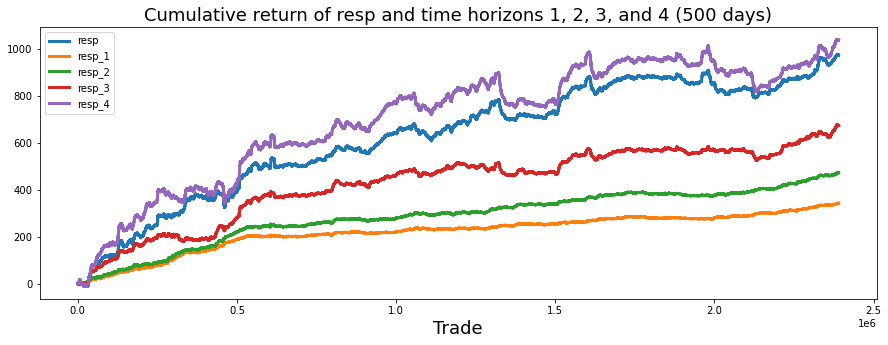

In [9]:
'''
Ближе всего к итоговому ответу resp_4, в целом этот признак очень сильно с ним коррелирован, можно даже посмотреть
их корреляцию и потом это как-то использовать как feature engineering и например предсказывать не только resp, а
resp_i по всем i, может будет работать
'''
fig, ax = plt.subplots(figsize=(15, 5))
balance = pd.Series(train_data['resp']).cumsum()
resp_1 = pd.Series(train_data['resp_1']).cumsum()
resp_2 = pd.Series(train_data['resp_2']).cumsum()
resp_3 = pd.Series(train_data['resp_3']).cumsum()
resp_4 = pd.Series(train_data['resp_4']).cumsum()
ax.set_xlabel ("Trade", fontsize=18)
ax.set_title ("Cumulative return of resp and time horizons 1, 2, 3, and 4 (500 days)", fontsize=18)
balance.plot(lw=3)
resp_1.plot(lw=3)
resp_2.plot(lw=3)
resp_3.plot(lw=3)
resp_4.plot(lw=3)
plt.legend(loc="upper left");

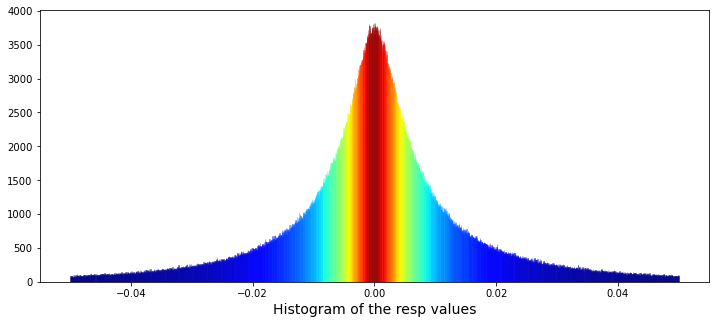

In [10]:
'''
Больше 90% resp лежат от -0.05 до +0.05. Мне кажется это тоже может быть полезной информацией, а внизу просто 
красивый график.
'''

plt.figure(figsize = (12,5))
ax = sns.distplot(train_data['resp'], 
                  bins=3000, 
                  kde_kws={"clip":(-0.05,0.05)}, 
                  hist_kws={"range":(-0.05,0.05)},
                  color='darkcyan', 
                  kde=False);
values = np.array([rec.get_height() for rec in ax.patches])
norm = plt.Normalize(values.min(), values.max())
colors = plt.cm.jet(norm(values))
for rec, col in zip(ax.patches, colors):
    rec.set_color(col)
plt.xlabel("Histogram of the resp values", size=14)
plt.show();

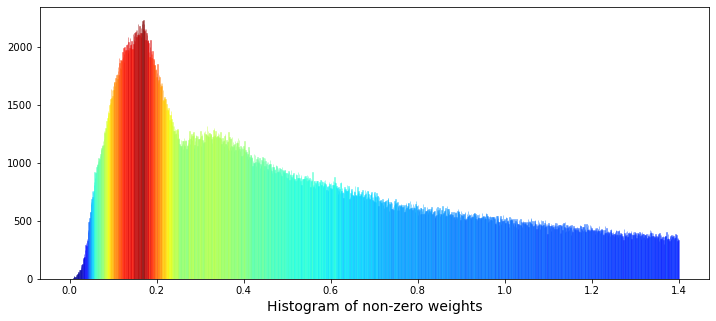

In [11]:
'''
Из weights тоже можно вытащить какую-то информацию.
Во-первых они больше нуля, а те веса, которые равны нулю, их около 17%, и они по идее не вносят вклад в итоговый скоре
Во-вторых мы видим два пика и автор этой визуализации делает предположение о том, что возможно это тоже можно использовать
'''
plt.figure(figsize = (12,5))
ax = sns.distplot(train_data['weight'], 
             bins=1400, 
             kde_kws={"clip":(0.001,1.4)}, 
             hist_kws={"range":(0.001,1.4)},
             color='darkcyan', 
             kde=False);
values = np.array([rec.get_height() for rec in ax.patches])
norm = plt.Normalize(values.min(), values.max())
colors = plt.cm.jet(norm(values))
for rec, col in zip(ax.patches, colors):
    rec.set_color(col)
plt.xlabel("Histogram of non-zero weights", size=14)
plt.show()

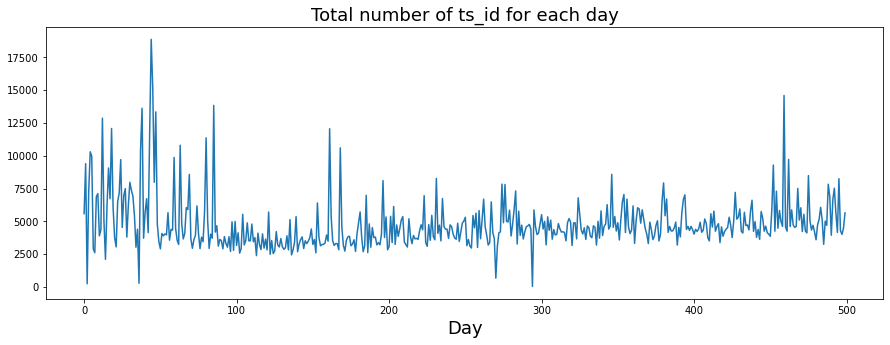

In [12]:
'''
Наши данные это временной ряд и мы можем посмотреть как менялось количество операций во времени.
В целом это может быть довольно важной информацией и мы можем это как-то использовать
'''
trades_per_day = train_data.groupby(['date'])['ts_id'].count()
fig, ax = plt.subplots(figsize=(15, 5))
plt.plot(trades_per_day)
ax.set_xlabel ("Day", fontsize=18)
ax.set_title ("Total number of ts_id for each day", fontsize=18)
plt.show()

#### Features

Features - это наши основные входные данные. В основном это просто какие-то цифры. На их фоне неплохо выделяется feature_0, которая принимает значения -1 и 1 и для некоторых features разделяет их на отрицательные и не отрицательные.

In [13]:
def plotFeatureSplits(df, feature_list):
    for i in feature_list:

        # Create a plot with original timeseries, and split by feature 0
        _, axes = plt.subplots(1, 2, figsize=(20, 5))

        # Original timeseries
        df[f'feature_{i}'].plot(ax=axes[0])
        axes[0].set_title(f'Feature {i}')
        axes[0].set_ylabel(f'Feature {i}')
        axes[0].set_xlabel(f'Trade ID')

        # Plot by feature 0 split
        df.groupby('feature_0')[f'feature_{i}'].plot(ax=axes[1])
        axes[1].set_title(f'Feature {i}, split by feature_0')
        axes[1].set_ylabel(f'Feature {i}')
        axes[1].set_xlabel(f'Trade ID')

        # Show figure with legend
        plt.legend()    
        plt.show()

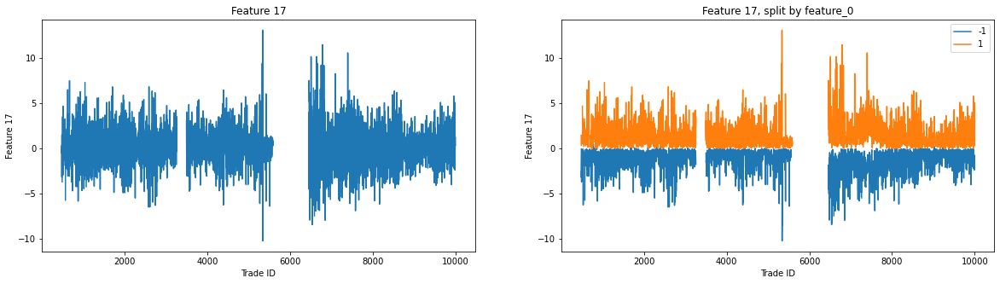

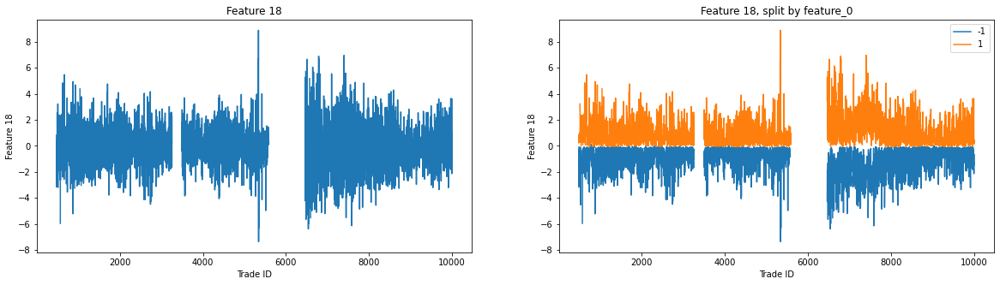

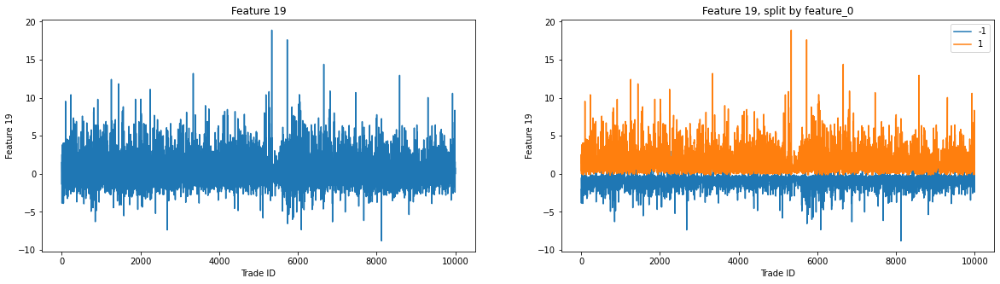

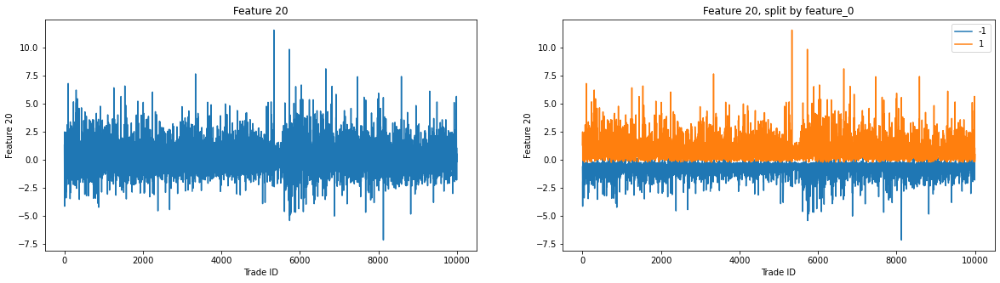

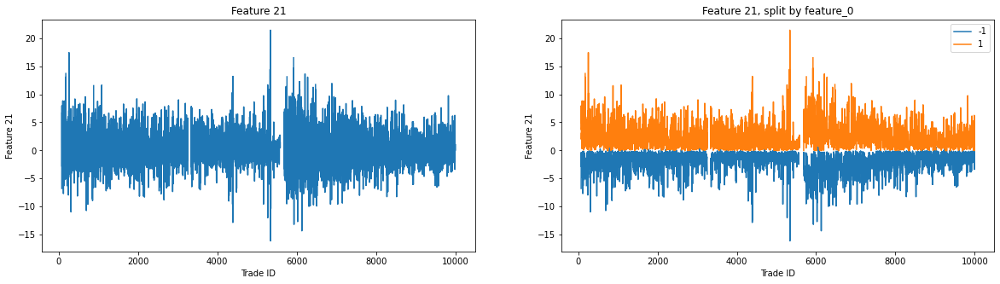

...

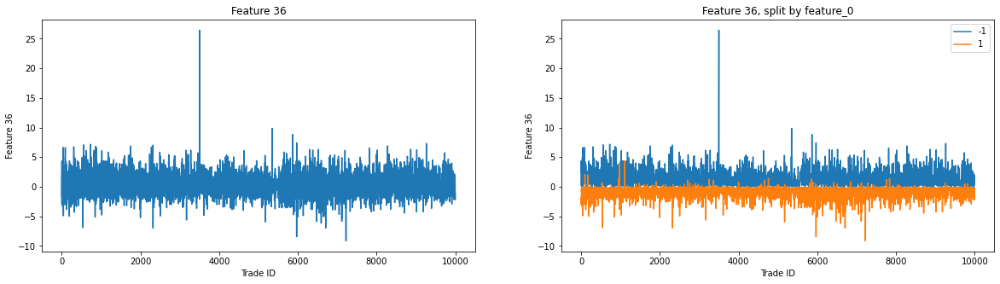

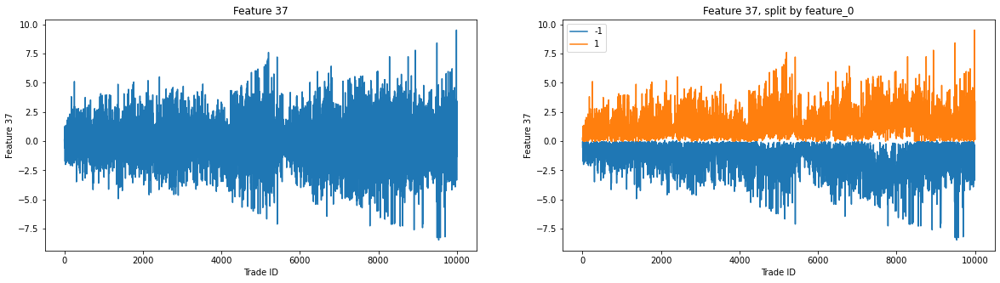

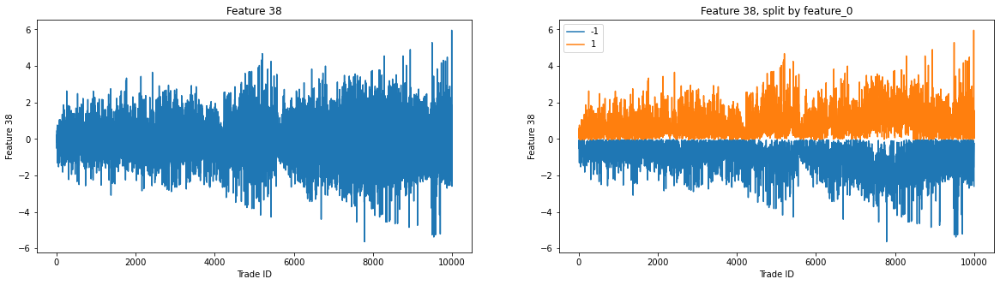

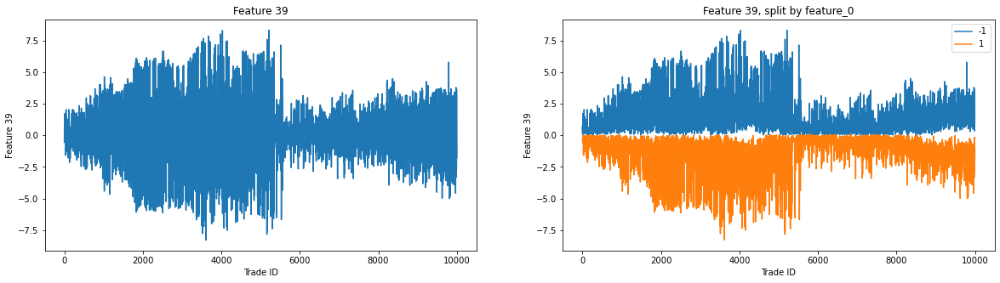

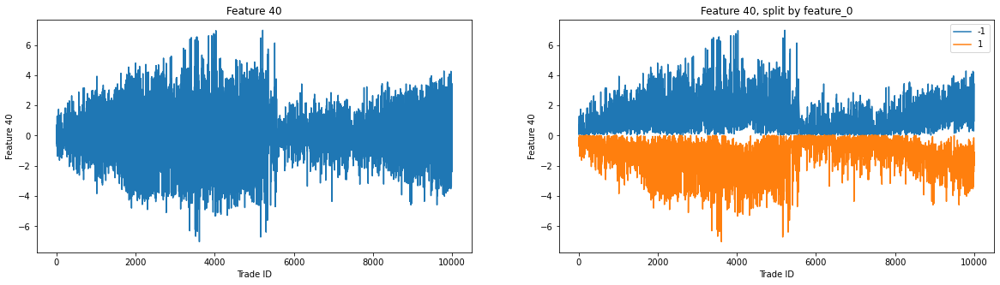

In [14]:
# Show pattern 1, features 17-40
plotFeatureSplits(train_data.iloc[:10000, :], np.arange(17, 41))

In [15]:
%%time
data_viz = train_data.fillna(0).sample(frac=0.1)
means = np.nanmean(data_viz[features], axis=0)
stds = np.nanstd(data_viz[features], axis=0)
data_viz = (data_viz[features] - means) / stds

Wall time: 9.12 s


In [16]:
%%time
# Create TriMap embeddings
trimap_embedding = trimap.TRIMAP(
  n_iters=1000,
  apply_pca=True,
  weight_adj=50
).fit_transform(data_viz.values)
print("Done with TriMap embeddings")

# Put embeddings into dataframe
embedding_df = pd.DataFrame({
    'Component 1': trimap_embedding[:, 0], 
    'Component 2': trimap_embedding[:, 1],
    'Feature 0': data_viz.feature_0.astype(str),
})

# Visualize the embeddings in 2D plot
fig = px.scatter(
    embedding_df, 
    x='Component 1', y='Component 2', 
    color='Feature 0',
    opacity=0.8
)
fig.update_traces(
    marker=dict(size=5, line=dict(width=1, color='DarkSlateGrey')),
    selector=dict(mode='markers')
)    
fig.update_layout(title={
    'text': f'TriMAP Embedding on Features 1-{len(features)+1}',
    'x':0.5,
    'xanchor': 'center',
    'yanchor': 'top'}
)
fig.show()

TRIMAP(n_inliers=10, n_outliers=5, n_random=5, distance=euclidean, lr=1000.0, n_iters=1000, weight_adj=50, apply_pca=True, opt_method=dbd, verbose=True, return_seq=False)
running TriMap on 239049 points with dimension 130
pre-processing
applied PCA
found nearest neighbors
sampled triplets
running TriMap with dbd
Iteration:  100, Loss: 1265.489, Violated triplets: 0.0096
Iteration:  200, Loss: 1110.107, Violated triplets: 0.0084
Iteration:  300, Loss: 1037.719, Violated triplets: 0.0079
Iteration:  400, Loss: 1002.619, Violated triplets: 0.0076
Iteration:  500, Loss: 984.742, Violated triplets: 0.0075
Iteration:  600, Loss: 973.293, Violated triplets: 0.0074
Iteration:  700, Loss: 965.147, Violated triplets: 0.0073
Iteration:  800, Loss: 958.961, Violated triplets: 0.0073
Iteration:  900, Loss: 954.075, Violated triplets: 0.0073
Iteration: 1000, Loss: 950.088, Violated triplets: 0.0072
Elapsed time: 0:11:50.423270
Done with TriMap embeddings


Wall time: 11min 59s


In [18]:
'''
Features могут быть четырех типов в зависимости от их куммулятивной суммы: linear, negative, noisy, hybrid.
Пока не понятно что делать с feature engineering, но стоит записать какие переменные к какому типу относятся
'''
linear = [1, 7, 9, 11, 13, 15, 17, 19, 21, 23, 25, 18, 20, 22, 24, 26, 27, 29, 21, 33, 35, 28, 30, 32, 34, 36,
          84, 85, 86, 87, 88, 90, 91, 92, 93, 94, 96, 97, 98, 99, 100, 102, 103, 104, 105, 106, 41, 46, 47, 48, 49,
          50, 51, 53, 54, 69, 89, 95, 101, 107, 108, 110, 111, 113, 114, 115, 116, 117, 118, 119, 120, 122, 124]
noisy = [3, 4, 5, 6, 8, 10, 12, 14, 16, 37, 38, 39, 40, 72, 73, 74, 75, 76, 78, 79, 80, 81, 82, 83]
negative = [73, 75, 76, 77, 79, 81, 82]
hybrid = [55, 56, 57, 58, 59]

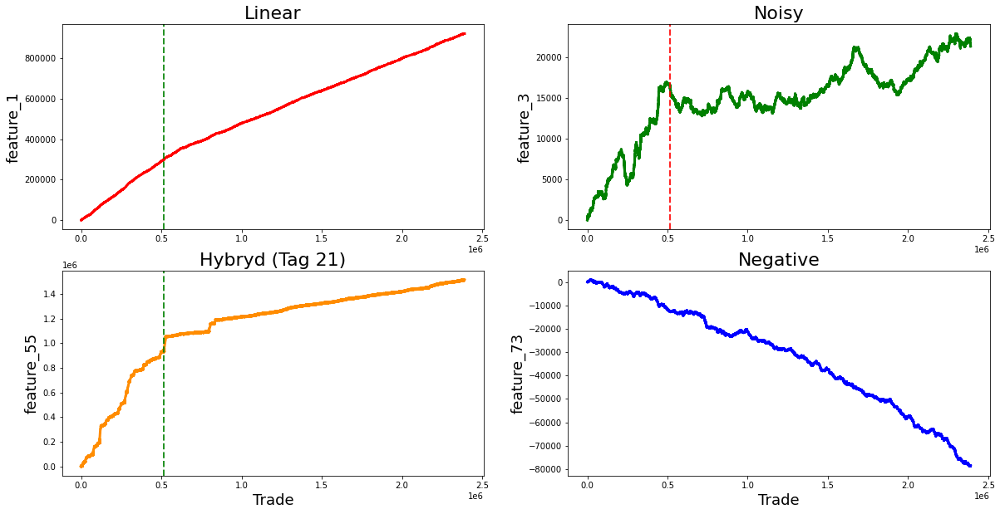

In [17]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2,figsize=(20,10))

ax1.plot((pd.Series(train_data['feature_1']).cumsum()), lw=3, color='red')
ax1.set_title ("Linear", fontsize=22);
ax1.axvline(x=514052, linestyle='--', alpha=0.85, c='green', lw=2)
ax1.set_ylabel ("feature_1", fontsize=18);

ax2.plot((pd.Series(train_data['feature_3']).cumsum()), lw=3, color='green')
ax2.set_title ("Noisy", fontsize=22);
ax2.axvline(x=514052, linestyle='--', alpha=0.85, c='red', lw=2)
ax2.set_ylabel ("feature_3", fontsize=18);

ax3.plot((pd.Series(train_data['feature_55']).cumsum()), lw=3, color='darkorange')
ax3.set_title ("Hybryd (Tag 21)", fontsize=22);
ax3.set_xlabel ("Trade", fontsize=18)
ax3.axvline(x=514052, linestyle='--', alpha=0.85, c='green', lw=2)
ax3.set_ylabel ("feature_55", fontsize=18);

ax4.plot((pd.Series(train_data['feature_73']).cumsum()), lw=3, color='blue')
ax4.set_title ("Negative", fontsize=22)
ax4.set_xlabel ("Trade", fontsize=18)
ax4.set_ylabel ("feature_73", fontsize=18);

In [20]:
'''
Еще есть файл с тегами, скорее всего feature engineering стоит основывать на нем
'''
feature_tags = pd.read_csv("features.csv" ,index_col=0)
feature_tags = feature_tags*1
tag_sum = pd.DataFrame(feature_tags.T.sum(axis=0),columns=['Number of tags'])
tag_sum.T

feature,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_120,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129
Number of tags,0,2,3,2,3,2,3,3,4,3,...,2,3,2,3,2,3,2,3,2,3


In [24]:
'''
По пропущенным фичам есть зависимости от количества пропусков и номеров этих фичей, в дальнейшем надо будет тоже с этим
поработать и посмотреть как все это соотносится с тегами
'''

gone = train_data.isna().sum()
px.bar(gone, color=gone.values, title="Total number of missing values for each column").show()

## Trees and Gradient Boosting

<b> Used Notebooks:</b><br>
    1) XGB-Starter - https://www.kaggle.com/wilddave/xgb-starter <br>
    2) XGBoost HyperOpt - https://www.kaggle.com/gogo827jz/jane-street-xgboost-grouptimesplitkfold?scriptVersionId=48297430 <br>

In [2]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score

### Random Forest

Посмотрим что может дать Random Forest, попробуем потюнить гиперпараметры с помощью hyperopt. Скорее всего выйдет не супер круто, но в рамках курса

In [3]:
from sklearn.ensemble import RandomForestClassifier

In [4]:
%%time
train_data_datatable = dt.fread('train.csv')
df = train_data_datatable.to_pandas()
df.shape

Wall time: 18 s


(2390491, 138)

In [13]:
# построим признак action, который нам и нужен, а также зададим features
df['action'] = (df['resp'] > 0).astype('int')
features = [col for col in df.columns if 'feature' in col]
df.fillna(-9999, inplace=True)

In [14]:
X, y = df[features], df['action']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
X_train.shape, X_test.shape

((1912392, 130), (478099, 130))

In [ ]:
%%time
model = RandomForestClassifier()
model.fit(X_train, y_train)

In [ ]:
preds = model.predict(X_test)

In [ ]:
accuracy_score(y_test, preds)